In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [2]:
import os

In [3]:
files = os.listdir(r'E:\Data Science\uber-pickups-in-new-york-city')[-7:]

In [4]:
files.remove('uber-raw-data-janjune-15.csv')

In [5]:
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [6]:
path = r'E:\Data Science\uber-pickups-in-new-york-city'

final=pd.DataFrame()

for file in files:
    df = pd.read_csv(path+'/'+file, encoding='utf-8')
    final = pd.concat([df,final])

In [7]:
final.shape

(4534327, 4)

In [8]:
df=final.copy()

In [9]:
df.head()

,Date/Time,Lat,Lon,Base
0,9/1/2014 0:01:00,40.2201,-74.0021,B02512
1,9/1/2014 0:01:00,40.7500,-74.0027,B02512
2,9/1/2014 0:03:00,40.7559,-73.9864,B02512
3,9/1/2014 0:06:00,40.7450,-73.9889,B02512
4,9/1/2014 0:11:00,40.8145,-73.9444,B02512


In [10]:
df.dtypes

Date/Time     object
Lat          float64
Lon          float64
Base          object
dtype: object

In [11]:
df['Date/Time']=pd.to_datetime(df['Date/Time'],format='%m/%d/%Y %H:%M:%S')

In [12]:
df.dtypes

Date/Time    datetime64[ns]
Lat                 float64
Lon                 float64
Base                 object
dtype: object

In [13]:
df.head()

,Date/Time,Lat,Lon,Base
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512


In [14]:
df['weekday'] = df['Date/Time'].dt.day_name()

In [15]:
df['day'] = df['Date/Time'].dt.day

In [16]:
df['minute'] = df['Date/Time'].dt.minute
df['month'] = df['Date/Time'].dt.month
df['hour'] = df['Date/Time'].dt.hour

In [17]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,month,hour
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,Monday,1,1,9,0
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,Monday,1,1,9,0
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,Monday,1,3,9,0
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512,Monday,1,6,9,0
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512,Monday,1,11,9,0


In [18]:
df.dtypes

Date/Time    datetime64[ns]
Lat                 float64
Lon                 float64
Base                 object
weekday              object
day                   int64
minute                int64
month                 int64
hour                  int64
dtype: object

### Q1 Analysis of journey by Week-days.

In [19]:
import plotly.express as px

In [20]:
px.bar(x=df['weekday'].value_counts().index,
      y=df['weekday'].value_counts())

In [21]:
df['weekday'].value_counts().index

Index(['Thursday', 'Friday', 'Wednesday', 'Tuesday', 'Saturday', 'Monday',
       'Sunday'],
      dtype='object')

### Q2 Analysis of journey by hour.

(array([216928., 103517., 227152., 543565., 324851., 366329., 819491.,
        660869., 579117., 692508.]),
 array([ 0. ,  2.3,  4.6,  6.9,  9.2, 11.5, 13.8, 16.1, 18.4, 20.7, 23. ]),
 <BarContainer object of 10 artists>)

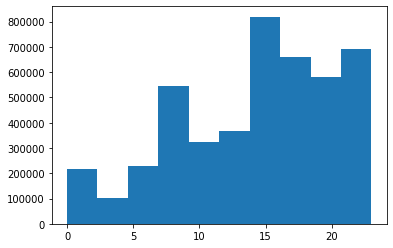

In [22]:
plt.hist(df['hour'])

In [23]:
df['month'].unique()

array([9, 5, 6, 7, 8, 4], dtype=int64)

In [24]:
for i,month in enumerate(df['month'].unique()):
    print(i,month)

0 9
1 5
2 6
3 7
4 8
5 4


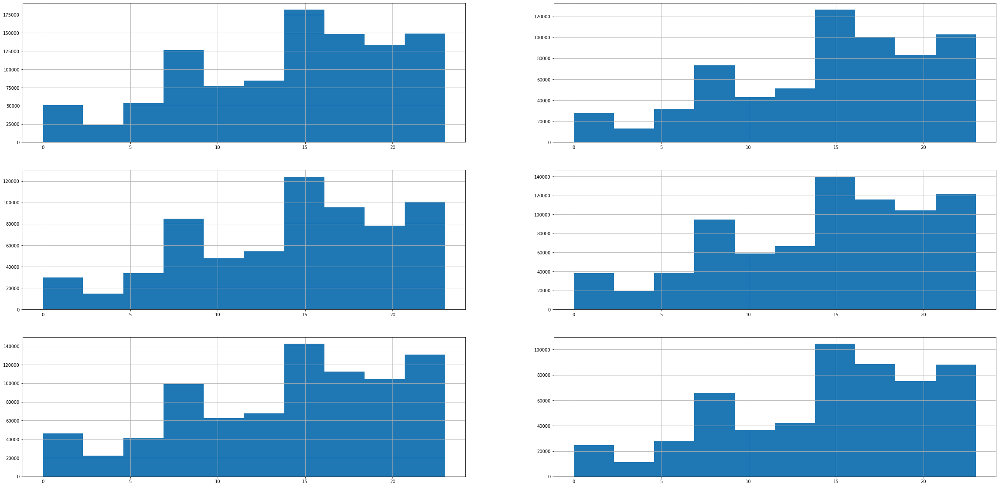

In [25]:
plt.figure(figsize=(40,20))

for i,month in enumerate(df['month'].unique()):
    plt.subplot(3,2,i+1)
    df[df['month']==month]['hour'].hist()
    

In [26]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,month,hour
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,Monday,1,1,9,0
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,Monday,1,1,9,0
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,Monday,1,3,9,0
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512,Monday,1,6,9,0
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512,Monday,1,11,9,0


### Q3 Analysis of which month has max rides

In [27]:
import chart_studio.plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

In [28]:
df.groupby('month')['hour'].count()

month
4     564516
5     652435
6     663844
7     796121
8     829275
9    1028136
Name: hour, dtype: int64

In [29]:
trace1 = go.Bar(x=df.groupby('month')['hour'].count().index,
      y=df.groupby('month')['hour'].count(),
      name='Priority')

In [30]:
iplot([trace1])

### Q4 Analysis of journey of Each Day

In [31]:
import seaborn as sns

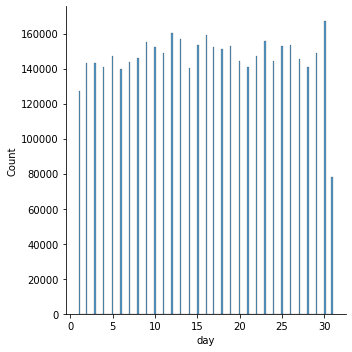

In [32]:
sns.displot(df['day'])

Text(0.5, 1.0, 'Journey by month day')

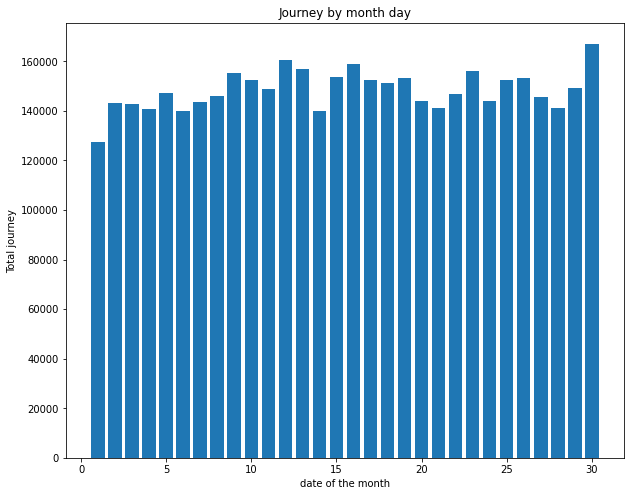

In [33]:
plt.figure(figsize=(10,8))
plt.hist(df['day'],bins=30, rwidth=0.8, range=(0.5,30.5))
plt.xlabel('date of the month')
plt.ylabel('Total journey')
plt.title('Journey by month day')

### Q5 Analysis of Total rides month wise

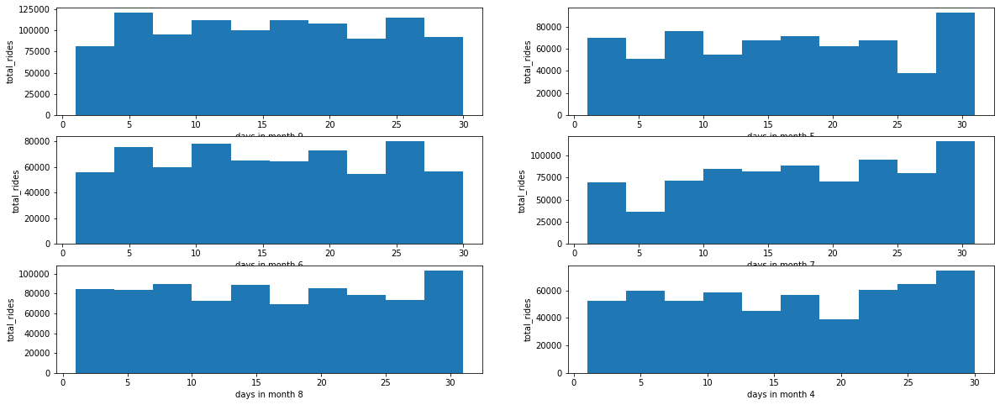

In [34]:
plt.figure(figsize=(20,8))

for i,month in enumerate(df['month'].unique(),1):
    plt.subplot(3,2,i)
    df_out = df[df['month']==month]
    plt.hist(df_out['day'])
    plt.xlabel('days in month {}'.format(month))
    plt.ylabel('total_rides')
    

### Q6 Analysing Rush in hour

Text(0.5, 1.0, 'Hours of day vs Latitude of Passanger')

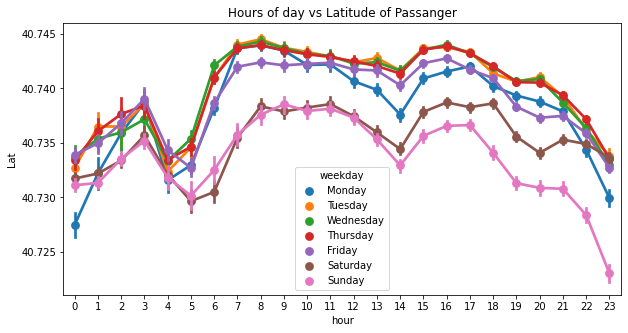

In [35]:
plt.figure(figsize=(10,5))
ax = sns.pointplot(x='hour', y='Lat', data=df, hue='weekday')
ax.set_title('Hours of day vs Latitude of Passanger')

In [36]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,month,hour
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,Monday,1,1,9,0
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,Monday,1,1,9,0
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,Monday,1,3,9,0
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512,Monday,1,6,9,0
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512,Monday,1,11,9,0


In [37]:
base = df.groupby(['Base', 'month'])['Date/Time'].count().reset_index()
base

,Base,month,Date/Time
0,B02512,4,35536
1,B02512,5,36765
2,B02512,6,32509
3,B02512,7,35021
4,B02512,8,31472
5,B02512,9,34370
6,B02598,4,183263
7,B02598,5,260549
8,B02598,6,242975
9,B02598,7,245597


<AxesSubplot:xlabel='month', ylabel='Date/Time'>

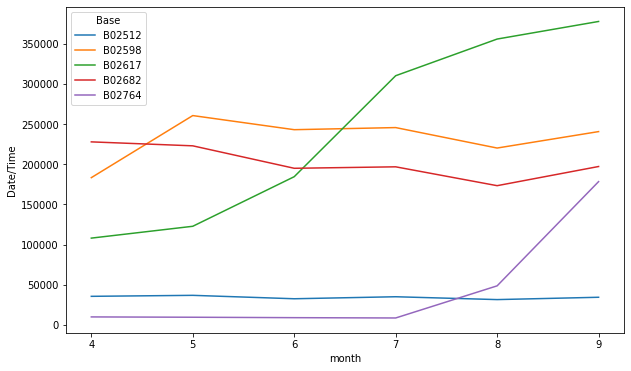

In [38]:
plt.figure(figsize=(10,6))
sns.lineplot(x='month', y='Date/Time', hue='Base', data=base)

In [39]:
def count_rows(rows):
    return len(rows)

In [40]:
by_cross = df.groupby(['weekday', 'hour']).apply(count_rows)
by_cross

weekday    hour
Friday     0       13716
           1        8163
           2        5350
           3        6930
           4        8806
                   ...  
Wednesday  19      47017
           20      47772
           21      44553
           22      32868
           23      18146
Length: 168, dtype: int64

In [41]:
pivot = by_cross.unstack()
pivot

hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
weekday,,,,,,,,,,,,,,,,,,,,,
Friday,13716,8163,5350,6930,8806,13450,23412,32061,31509,25230,...,36206,43673,48169,51961,54762,49595,43542,48323,49409,41260
Monday,6436,3737,2938,6232,9640,15032,23746,31159,29265,22197,...,28157,32744,38770,42023,37000,34159,32849,28925,20158,11811
Saturday,27633,19189,12710,9542,6846,7084,8579,11014,14411,17669,...,31418,38769,43512,42844,45883,41098,38714,43826,47951,43174
Sunday,32877,23015,15436,10597,6374,6169,6596,8728,12128,16401,...,28151,31112,33038,31521,28291,25948,25076,23967,19566,12166
Thursday,9293,5290,3719,5637,8505,14169,27065,37038,35431,27812,...,36699,44442,50560,56704,55825,51907,51990,51953,44194,27764
Tuesday,6237,3509,2571,4494,7548,14241,26872,36599,33934,25023,...,34846,41338,48667,55500,50186,44789,44661,39913,27712,14869
Wednesday,7644,4324,3141,4855,7511,13794,26943,36495,33826,25635,...,35148,43388,50684,55637,52732,47017,47772,44553,32868,18146


<AxesSubplot:xlabel='hour', ylabel='weekday'>

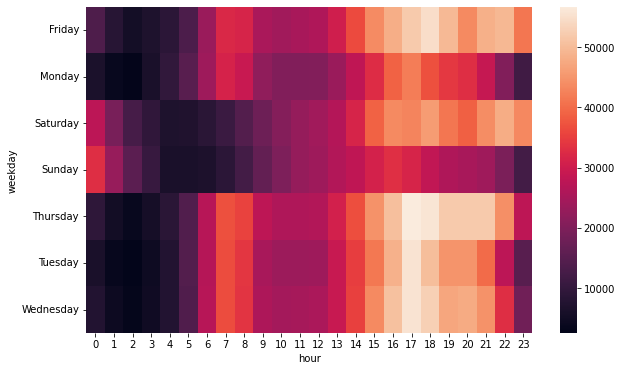

In [42]:
plt.figure(figsize=(10,6))
sns.heatmap(pivot)

In [43]:
def heatmap(col1, col2):
    by_cross = df.groupby([col1, col2]).apply(count_rows)
    pivot = by_cross.unstack()
    plt.figure(figsize=(10,6))
    return sns.heatmap(pivot)


<AxesSubplot:xlabel='hour', ylabel='day'>

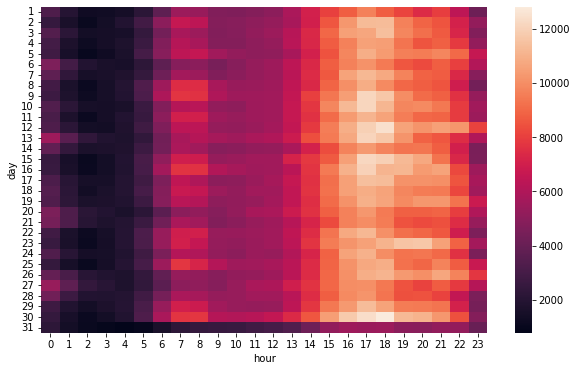

In [44]:
heatmap('day','hour')

<AxesSubplot:xlabel='hour', ylabel='month'>

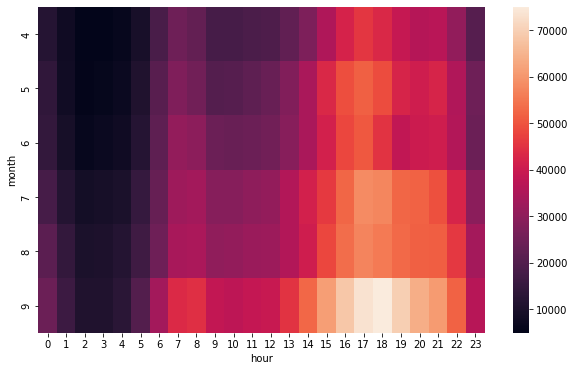

In [45]:
heatmap('month', 'hour')

<AxesSubplot:xlabel='weekday', ylabel='month'>

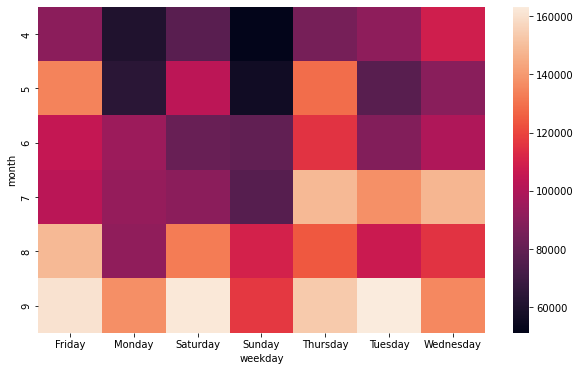

In [46]:
heatmap('month', 'weekday')

### Q8 Analysis of location data points

In [47]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,month,hour
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,Monday,1,1,9,0
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,Monday,1,1,9,0
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,Monday,1,3,9,0
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512,Monday,1,6,9,0
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512,Monday,1,11,9,0


(40.5, 41.0)

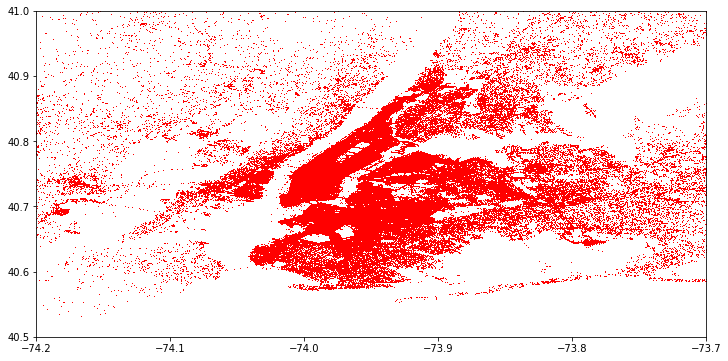

In [67]:
plt.figure(figsize=(12,6))
plt.plot(df['Lon'],df['Lat'],'r+',ms=0.5)
plt.xlim(-74.2,-73.7)
plt.ylim(40.5,41)

### Q9 Spatial analysis using heatmap to get a clear cut of rush

In [49]:
df_out = df[df['weekday']=='Sunday']

In [50]:
df_out.shape

(490180, 9)

In [51]:
df_out.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,month,hour
8011,2014-09-07 00:00:00,40.7341,-74.0005,B02512,Sunday,7,0,9,0
8012,2014-09-07 00:00:00,40.7344,-73.9900,B02512,Sunday,7,0,9,0
8013,2014-09-07 00:00:00,40.7806,-73.9582,B02512,Sunday,7,0,9,0
8014,2014-09-07 00:01:00,40.7293,-73.9859,B02512,Sunday,7,1,9,0
8015,2014-09-07 00:01:00,40.7713,-74.0133,B02512,Sunday,7,1,9,0


In [52]:
rush = df_out.groupby(['Lat','Lon'])['weekday'].count().reset_index()

In [53]:
rush.columns=['Lat','Lon','no of trips']

In [54]:
rush

,Lat,Lon,no of trips
0,39.9374,-74.0722,1
1,39.9378,-74.0721,1
2,39.9384,-74.0742,1
3,39.9385,-74.0734,1
4,39.9415,-74.0736,1
...,...,...,...
209225,41.3141,-74.1249,1
209226,41.3180,-74.1298,1
209227,41.3195,-73.6905,1
209228,41.3197,-73.6903,1


In [55]:
!pip install folium

You should consider upgrading via the 'C:\Users\anil1\AppData\Local\Programs\Python\Python310\python.exe -m pip install --upgrade pip' command.


In [56]:
from folium.plugins import HeatMap

In [57]:
import folium

In [58]:
basemap = folium.Map()

In [59]:
HeatMap(rush,zoom=20,radius=15).add_to(basemap)

In [60]:
basemap

### Q10 Automate your analysis

In [61]:
def plot(df,day):
    basemap = folium.Map()
    df_out = df[df['weekday']==day]
    HeatMap(df_out.groupby(['Lat','Lon'])['weekday'].count().reset_index(),zoom=20,radius=15).add_to(basemap)
    return basemap

In [62]:
plot(df,'Saturday')

In [63]:
uber_15 = pd.read_csv(r"E:\Data Science\uber-pickups-in-new-york-city\uber-raw-data-janjune-15.csv")

In [68]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID
0,B02617,2015-05-17 09:47:00,B02617,141
1,B02617,2015-05-17 09:47:00,B02617,65
2,B02617,2015-05-17 09:47:00,B02617,100
3,B02617,2015-05-17 09:47:00,B02774,80
4,B02617,2015-05-17 09:47:00,B02617,90


In [69]:
uber_15

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID
0,B02617,2015-05-17 09:47:00,B02617,141
1,B02617,2015-05-17 09:47:00,B02617,65
2,B02617,2015-05-17 09:47:00,B02617,100
3,B02617,2015-05-17 09:47:00,B02774,80
4,B02617,2015-05-17 09:47:00,B02617,90
...,...,...,...,...
14270474,B02765,2015-05-08 15:43:00,B02765,186
14270475,B02765,2015-05-08 15:43:00,B02765,263
14270476,B02765,2015-05-08 15:43:00,B02765,90
14270477,B02765,2015-05-08 15:44:00,B01899,45


In [72]:
uber_15['Pickup_date']=pd.to_datetime(uber_15['Pickup_date'],format='%Y-%m-%d %H:%M:%S')

In [75]:
uber_15.dtypes

Dispatching_base_num            object
Pickup_date             datetime64[ns]
Affiliated_base_num             object
locationID                       int64
dtype: object

In [82]:
uber_15['weekday']=uber_15['Pickup_date'].dt.day_name()
uber_15['day']=uber_15['Pickup_date'].dt.day
uber_15['minute']=uber_15['Pickup_date'].dt.minute
uber_15['month']=uber_15['Pickup_date'].dt.month_name()
uber_15['hour']=uber_15['Pickup_date'].dt.hour

In [83]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,weekday,day,minute,month,hour
0,B02617,2015-05-17 09:47:00,B02617,141,Sunday,17,47,May,9
1,B02617,2015-05-17 09:47:00,B02617,65,Sunday,17,47,May,9
2,B02617,2015-05-17 09:47:00,B02617,100,Sunday,17,47,May,9
3,B02617,2015-05-17 09:47:00,B02774,80,Sunday,17,47,May,9
4,B02617,2015-05-17 09:47:00,B02617,90,Sunday,17,47,May,9


In [84]:
uber_15['month'].value_counts()

June        2816895
May         2695553
April       2280837
February    2263620
March       2259773
January     1953801
Name: month, dtype: int64

In [87]:

px.bar(x = uber_15['month'].value_counts().index,
      y = uber_15['month'].value_counts())


### Analysing Rush in New York City

C:\Users\anil1\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



<AxesSubplot:xlabel='hour', ylabel='count'>

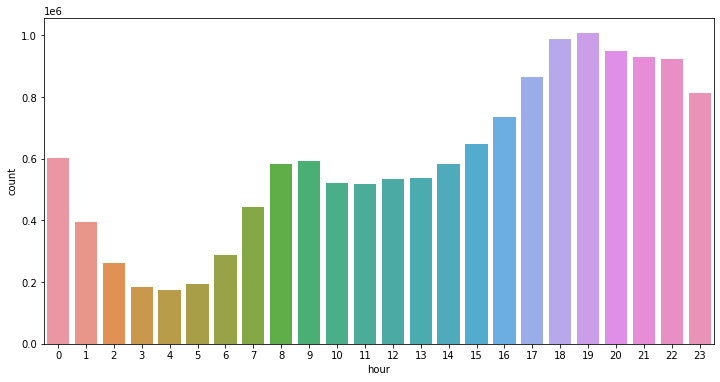

In [89]:
plt.figure(figsize=(12,6))
sns.countplot(uber_15['hour'])

In [93]:
summary = uber_15.groupby(['weekday', 'hour'])['Pickup_date'].count().reset_index()
summary.head()

,weekday,hour,Pickup_date
0,Friday,0,85939
1,Friday,1,46616
2,Friday,2,28102
3,Friday,3,19518
4,Friday,4,23575


In [95]:
summary.columns = (['weekday', 'hour', 'counts'])
summary.head()

,weekday,hour,counts
0,Friday,0,85939
1,Friday,1,46616
2,Friday,2,28102
3,Friday,3,19518
4,Friday,4,23575


<AxesSubplot:xlabel='hour', ylabel='counts'>

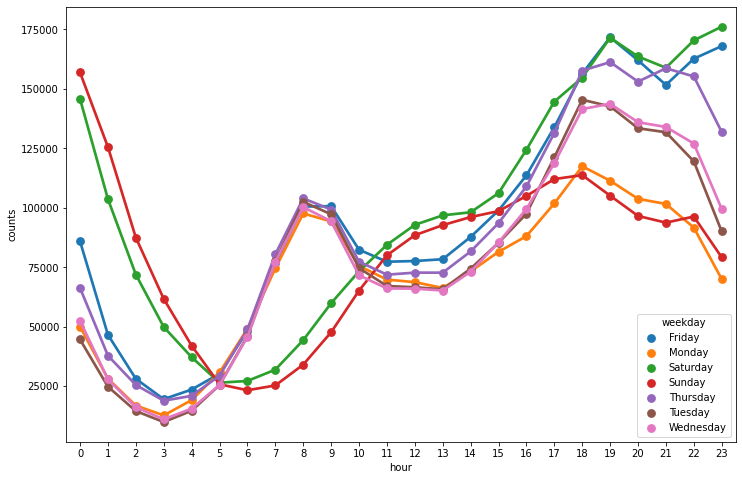

In [99]:
plt.figure(figsize=(12,8))
sns.pointplot(x = 'hour', y = 'counts', hue = 'weekday', data = summary)

In [100]:
uber_foil = pd.read_csv(r"D:\Data Science\uber-pickups-in-new-york-city\Uber-Jan-Feb-FOIL.csv")

In [101]:
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips
0,B02512,1/1/2015,190,1132
1,B02765,1/1/2015,225,1765
2,B02764,1/1/2015,3427,29421
3,B02682,1/1/2015,945,7679
4,B02617,1/1/2015,1228,9537


In [103]:
uber_foil.shape

(354, 4)

In [104]:
uber_foil['dispatching_base_number'].unique()

array(['B02512', 'B02765', 'B02764', 'B02682', 'B02617', 'B02598'],
      dtype=object)

### Analysing which base number has most active vehicle

<AxesSubplot:xlabel='dispatching_base_number', ylabel='active_vehicles'>

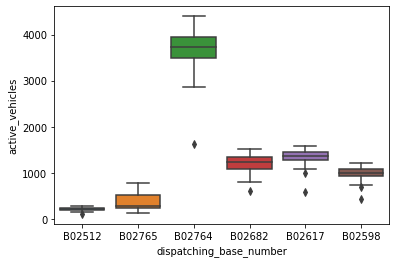

In [106]:
sns.boxplot(x = 'dispatching_base_number', y = 'active_vehicles', data = uber_foil)

### Analysing which base number has most trips

<AxesSubplot:xlabel='dispatching_base_number', ylabel='trips'>

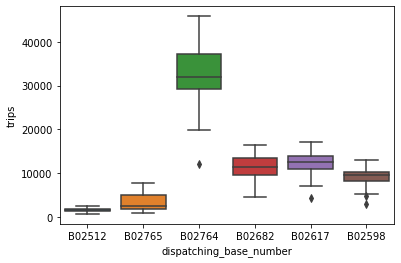

In [107]:
sns.boxplot(x = 'dispatching_base_number', y = 'trips', data = uber_foil)

### How average trips/vehicle inc/dec with dates with each base number ?

In [108]:
uber_foil['trips/vehicle'] = uber_foil['trips']/uber_foil['active_vehicles']

In [109]:
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips,trips/vehicle
0,B02512,1/1/2015,190,1132,5.957895
1,B02765,1/1/2015,225,1765,7.844444
2,B02764,1/1/2015,3427,29421,8.585060
3,B02682,1/1/2015,945,7679,8.125926
4,B02617,1/1/2015,1228,9537,7.766287


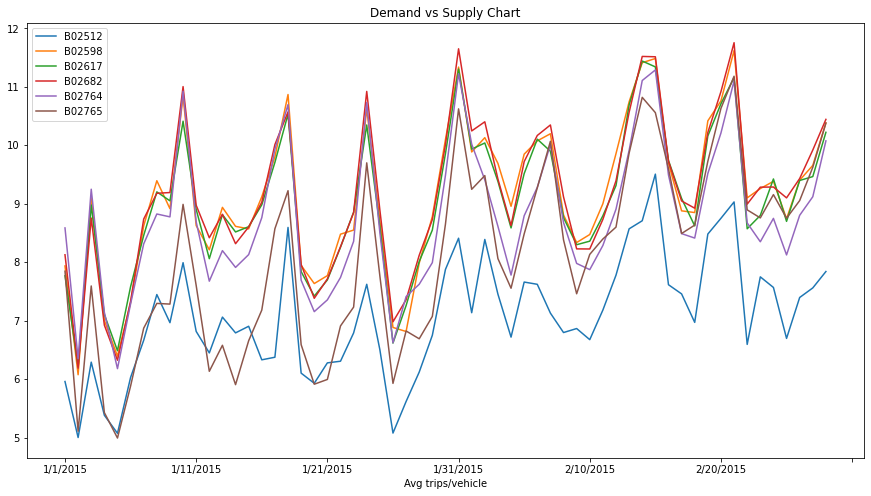

In [113]:
plt.figure(figsize=(15,8))
uber_foil.set_index('date').groupby(['dispatching_base_number'])['trips/vehicle'].plot()
plt.xlabel('Avg trips/vehicle')
plt.title('Demand vs Supply Chart')
plt.legend()